In [1]:
import numpy as np # linear algebra
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt # plotting
import numpy as np # linear algebra
import os # accessing directory structure
import pandas as pd # data processing, CSV f
from sklearn.impute import KNNImputer
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.preprocessing import scale 
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import roc_auc_score,roc_curve
import statsmodels.formula.api as smf
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error, r2_score

In [2]:
df = pd.read_csv("C:/Users/goyal/Downloads/Life Expectancy Data_HV22.csv")

In [3]:
lindata = df.copy()

In [4]:
df

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [5]:
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

In [6]:
df.columns = ['Country', 'Year', 'Status', 'Life Expectancy', 'Adult Mortality',
       'Infant deaths', 'Alcohol', 'Percentage Expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'Under-five deaths', 'Polio', 'Total Expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population',
       'Thinness  1-19 years', 'Thinness 5-9 years',
       'Income composition of resources', 'Schooling']

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life Expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   Infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   Percentage Expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2904 non-null   float64
 11  Under-five deaths                2938 non-null   int64  
 12  Polio               

In [8]:
gkk = df.groupby(['Year','Status'])
gkk.first()

Country  Life Expectancy  Adult Mortality  Infant deaths  \
Year Status                                                                     
2000 Developed     Australia             79.5             78.0              1   
     Developing  Afghanistan             54.8            321.0             88   
2001 Developed     Australia             79.9             75.0              1   
     Developing  Afghanistan             55.3            316.0             88   
2002 Developed     Australia             79.9             73.0              1   
     Developing  Afghanistan             56.2              3.0             88   
2003 Developed     Australia             83.0             71.0              1   
     Developing  Afghanistan             56.7            295.0             87   
2004 Developed     Australia             86.0             69.0              1   
     Developing  Afghanistan             57.0            293.0             87   
2005 Developed     Australia             81.0             67.0              1   
     Developing  Afghanistan             57.3            291.0             85   
2006 Developed     Australia             81.2             66.0              1   
     Developing  Afghanistan             57.3            295.0             84   
2007 Developed     Australia             81.3             66.0              1   
     Developing  Afghanistan             57.5            295.0             82   
2008 Developed     Australia             81.3             66.0              1   
     Developing  Afghanistan             58.1            287.0             80   
2009 Developed     Australia             81.7             66.0              1   
     Developing  Afghanistan             58.6            281.0             77   
2010 Developed     Australia             81.9             64.0              1   
     Developing  Afghanistan             58.8            279.0             74   
2011 Developed     Australia             82.0             63.0              1   
     Developing  Afghanistan             59.2            275.0             71   
2012 Developed     Australia             82.3             61.0              1   
     Developing  Afghanistan             59.5            272.0             69   
2013 Developed     Australia             82.5             61.0              1   
     Developing  Afghanistan             59.9            268.0             66   
2014 Developed     Australia             82.7              6.0              1   
     Developing  Afghanistan             59.9            271.0             64   
2015 Developed     Australia             82.8             59.0              1   
     Developing  Afghanistan             65.0            263.0             62   

                 Alcohol  Percentage Expenditure  Hepatitis B  Measles   BMI  \
Year Status                                                                    
2000 Developed     10.17              347.187360         33.0      108  58.2   
     Developing     0.01               10.424960         62.0     6532  12.2   
2001 Developed      9.53             3064.301144         94.0      141  59.0   
     Developing     0.01               10.574728         63.0     8762  12.6   
2002 Developed      9.84               46.387182         95.0       32  59.6   
     Developing     0.01               16.887351         64.0     2486  13.0   
2003 Developed      9.97             3829.550928         95.0       91   6.3   
     Developing     0.01               11.089053         65.0      798  13.4   
2004 Developed      9.84              588.568371         95.0       70   6.9   
     Developing     0.02               15.296066         67.0      466  13.8   
2005 Developed     10.30              579.133164         95.0       10  61.5   
     Developing     0.02                1.388648         66.0     1296  14.2   
2006 Developed     10.31             6187.062017         95.0        0  62.0   
     Developing     0.03               17.171518         64.0     

## **DATA PRE-PROCESSING**

In [9]:
df.columns

Index(['Country', 'Year', 'Status', 'Life Expectancy', 'Adult Mortality',
       'Infant deaths', 'Alcohol', 'Percentage Expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'Under-five deaths', 'Polio', 'Total Expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'Thinness  1-19 years',
       'Thinness 5-9 years', 'Income composition of resources', 'Schooling'],
      dtype='object')

In [10]:
!pip install fancyimpute

In [11]:
from fancyimpute import IterativeImputer
mice_imputer = IterativeImputer()

df1 = mice_imputer.fit_transform(df[['Adult Mortality']])
df2 = mice_imputer.fit_transform(df[['Life Expectancy']])
df3 = mice_imputer.fit_transform(df[['Diphtheria']])
df4 = mice_imputer.fit_transform(df[['Polio']])
df['Adult Mortality'] = df1
df['Life Expectancy'] = df2
df['Diphtheria'] = df3
df['Polio'] = df4
column = ['GDP']
country_index_c = df[(df['GDP'].isnull())].index

developing_gdp_mean = df[df['Status']=='Developing'].mean(skipna=True, numeric_only=True).GDP
developed_gdp_mean = df[df['Status']=='Developed'].mean(skipna=True, numeric_only=True).GDP

# for i in country_index_c:
#     if df['Status'][i] == 'Developed':
#         df.at[i, column] = developed_gdp_mean
#     if df['Status'][i] == 'Developing':
#         df.at[i, column] = developing_gdp_mean

**Observation** - *Applying **MICE()** for filling the NA values which reneralises and takes upon mean of the whole column and then fill it.*

In [12]:
m1 = df["Population"].mean()
df["Population"].replace(np.nan, m1, inplace=True)
m2 = int(df['Hepatitis B'].mean())
df['Hepatitis B'].replace(np.nan, m2, inplace=True)
m3 = int(df['Thinness  1-19 years'].mean())
df['Thinness  1-19 years'].replace(np.nan, m3, inplace=True)
m4 =int(df['Thinness 5-9 years'].mean())
df['Thinness 5-9 years'].replace(np.nan, m4, inplace=True)
m5 = int(df['Total Expenditure'].mean())
df['Total Expenditure'].replace(np.nan, m4, inplace=True)

**Observation** - *Taking out the mean of the column and filling the NA Values of each column*

In [13]:
df['Alcohol'] = df['Alcohol'].fillna(method="bfill")
df['GDP'] = df['GDP'].fillna(method="bfill")
df['Alcohol'] = df['Alcohol'].fillna(method="bfill")
df['Income composition of resources'] = df['Income composition of resources'].fillna(method= 'ffill')
df['Schooling'] = df['Schooling'].fillna(method= 'ffill')
df['BMI'] = df['BMI'].fillna(method = 'ffill')

**Observation** - *Applying **bfill()** which takes previous value from the column and **ffill()** which takes next value from the column *

In [14]:
df.isna().sum()

Country                            0
Year                               0
Status                             0
Life Expectancy                    0
Adult Mortality                    0
Infant deaths                      0
Alcohol                            0
Percentage Expenditure             0
Hepatitis B                        0
Measles                            0
BMI                                0
Under-five deaths                  0
Polio                              0
Total Expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
Thinness  1-19 years               0
Thinness 5-9 years                 0
Income composition of resources    0
Schooling                          0
dtype: int64

**Observation** - *It proves that there are no null values present in the dataset now*

**Creating the Categories in the Dataset**

In [15]:
rate = []
for i in df['Infant deaths']:
    if i > df['Infant deaths'].mean():
        rate.append("High Rate")
    else:
        rate.append("Low Rate")
df['Rate of Infant Death'] = rate

In [16]:
df['Rate of Infant Death'].value_counts()

Low Rate     2385
High Rate     553
Name: Rate of Infant Death, dtype: int64

In [17]:
school = []
for i in df['Schooling']:
    if i > 5:
        school.append("Good Schooling")
    else:
        school.append("Not Good Schooling")
df['Quality of Schooling'] = school

In [18]:
df['Quality of Schooling'].value_counts()

Good Schooling        2835
Not Good Schooling     103
Name: Quality of Schooling, dtype: int64

In [19]:
life = []
for i in df['Life Expectancy']:
    if i >= 65:
        life.append("High")
    else:
        life.append("Low")
df['Life Expectancy Rating'] = life

In [20]:
df['Life Expectancy Rating'].value_counts()

High    2087
Low      851
Name: Life Expectancy Rating, dtype: int64

In [21]:
expenditure = []
for i in df['Percentage Expenditure']:
    if i > df['Percentage Expenditure'].mean():
        expenditure.append("High")
    elif i == 0.00:
        expenditure.append("Poor")
    else:
        expenditure.append("Medium")
df['Expenditure Category'] = expenditure

In [22]:
df['Expenditure Category'].value_counts()

Medium    1813
Poor       611
High       514
Name: Expenditure Category, dtype: int64

In [23]:
mortality = []
for i in df['Adult Mortality']:
    if i > df['Adult Mortality'].mean():
        mortality.append("High Mortality")
    else:
        mortality.append("Low Mortality")
df['Adult Mortality Rating'] = mortality

In [24]:
df['Adult Mortality Rating'].value_counts()

Low Mortality     1709
High Mortality    1229
Name: Adult Mortality Rating, dtype: int64

In [25]:
df['Population'].mean()
density = []
for i in df['Population']:
    if i > df['Population'].mean():
        density.append("High Density")
    else:
        density.append("Low Density")
df['Population Density'] = density

In [26]:
df

,Country,Year,Status,Life Expectancy,Adult Mortality,Infant deaths,Alcohol,Percentage Expenditure,Hepatitis B,Measles,...,Thinness 1-19 years,Thinness 5-9 years,Income composition of resources,Schooling,Rate of Infant Death,Quality of Schooling,Life Expectancy Rating,Expenditure Category,Adult Mortality Rating,Population Density
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,17.2,17.3,0.479,10.1,High Rate,Good Schooling,High,Medium,High Mortality,High Density
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,17.5,17.5,0.476,10.0,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,17.7,17.7,0.470,9.9,High Rate,Good Schooling,Low,Medium,High Mortality,High Density
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,17.9,18.0,0.463,9.8,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,18.2,18.2,0.454,9.5,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,9.4,9.4,0.407,9.2,Low Rate,Good Schooling,Low,Poor,High Mortality,High Density
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,9.8,9.9,0.418,9.5,Low Rate,Good Schooling,Low,Poor,High Mortality,Low Density
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,1.2,1.3,0.427,10.0,Low Rate,Good Schooling,Low,Poor,Low Mortality,Low Density
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,1.6,1.7,0.427,9.8,Low Rate,Good Schooling,Low,Poor,High Mortality,Low Density


## **QUESTIONS**

**Q1: Do all the features available in the dataset really affect the Life expectancy? What are the predicting variables actually affecting the life expectancy?**

<ipython-input-27-b1596755e4d1>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(),annot = True)


<AxesSubplot:>

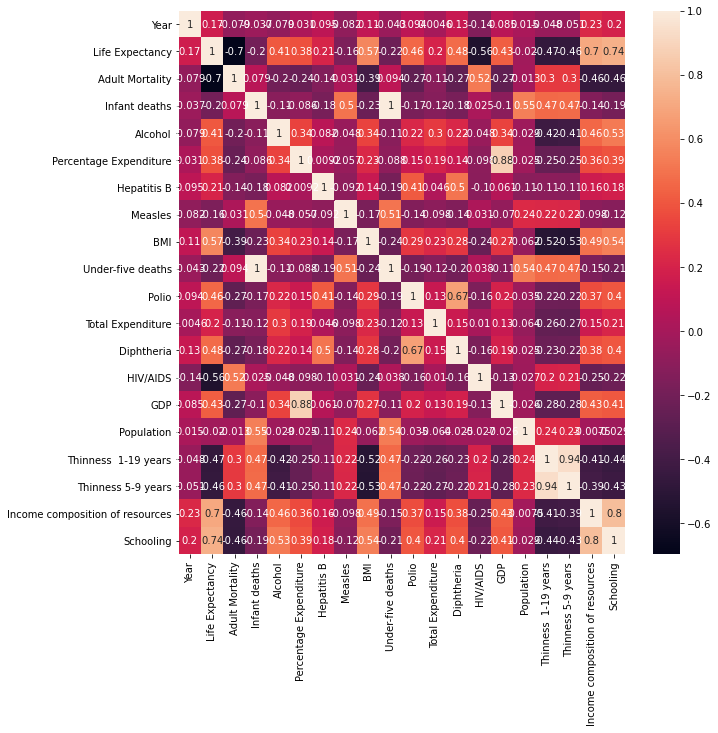

In [27]:
plt.figure(1, figsize=(10,10))
sns.heatmap(df.corr(),annot = True)

**Observation :** *Life expectancy is positively correlated with education, resource income composition, GDP, diphtheria, polio, and percentage spending.
Life expectancy is negatively correlated with Adult_mortality ,Thinness_1-19_years, Thinness_5-9_years, HIV / AIDS, Under_five_deaths, and Infant_deaths.
infant deaths is positively correlated with under-five deaths
adult mortality is negatively correlated with life expectancy, income compositions of resources, schooling and positive correlated with HIV/AIDS and alcohol consumption.*

**Q2: Should a country having a lower life expectancy value(<65) increase its healthcare expenditure in order to improve its average lifespan?** 

In [28]:
px.scatter(df, x = 'Life Expectancy', y = 'Percentage Expenditure', color = 'Country', 
           size = 'Year', template = 'plotly_dark',
           title = '<b>Life Expectancy Versus Percentage Expenditure')

**Observation** - *Above graph shows that more life expenditure, increases the life expectancy.*

**Q3: How does Infant and Adult mortality rates affect life expectancy?**

In [29]:
px.scatter(df, x = 'Life Expectancy', y = 'Adult Mortality',
           color = 'Country', template = 'plotly_dark', size = 'Life Expectancy',opacity = 0.6, 
           title = '<b>Life Expectancy Vs Adult Mortality in Countries')

**Observation** - *Life Expectancy versus the adult Mortality in different countries every year*

In [30]:
px.scatter(df.sort_values(by = 'Year'),x = 'Life Expectancy', y = 'Under-five deaths', color = 'Country', 
           size = 'Year', template = 'plotly_dark', opacity = 0.6,title = 'Life expectancy VS Infant Death of Countries in Every Year')

**Observation** - *Above graph shows that more infant death low life expectancy. e.g India had 1800 infant death in year 2000 and the life expectancy rate in year 2000 was 62.5 on other hand in 2015 infant death decreases to 910 and life expectancy increases to 68.3. So life expectancy is directly propotional to the death of the infant per year.*

**Q4: What is the impact of schooling on the lifespan of humans?**

In [31]:
px.scatter(df.sort_values(by='Year'), x = 'Life Expectancy', y = 'Schooling', color = 'Country',
          size = 'Year',animation_frame = 'Year', animation_group = 'Country',template = 'plotly_dark',
           title = '<b>Life Expectancy Vs Schooling in Countries')

**Observation** - *Life Expectancy versus the Schooling in different countries is positively correlated to each other as one increases the other does too.*

**Q5: Does Life Expectancy have positive or negative relationship with drinking alcohol?**

In [32]:
px.scatter(df.sort_values(by='Year'),x = 'Life Expectancy', y = 'Alcohol',color = 'Country', 
           size = 'Alcohol',animation_frame = 'Year', animation_group = 'Country',template = 'plotly_dark',
           labels = {'Alcohol' : 'Alcohol', 'Life Expectancy' : 'Life Expectancy'},
           title = '<b> Life Expectancy Vs Alcohol Addiction in Countries Over the Years')

**Observation** - *Above graph shows that more the alcohol consumption leads to decrease in life expectancy*

**Q6: Do densely populated countries tend to have lower life expectancy?**

Life Expectancy Rating  False  True 
Population Density                  
False                    1825    703
True                      262    148


<AxesSubplot:xlabel='Population Density'>

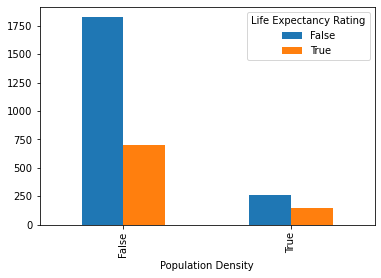

In [33]:
CrosstabResult=pd.crosstab(index=df['Population Density'] == 'High Density',columns=df['Life Expectancy Rating']== 'Low')
print(CrosstabResult)
 
# Grouped bar chart between GENDER and APPROVE_LOAN
#%matplotlib inline # only needed for jupyter notebook
CrosstabResult.plot.bar()

**Observation** - *Yes, densely populated countries tend to have lower life expectancy as shown in the graph true values prove it.*

**Q7: What is the impact of Immunization coverage on life Expectancy?**

## **EDA**

<ipython-input-34-af70b1fca7d9>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Schooling                          0.737439
Income composition of resources    0.704603
Adult Mortality                    0.696359
BMI                                0.572406
HIV/AIDS                           0.556457
Diphtheria                         0.475418
Thinness  1-19 years               0.469573
Thinness 5-9 years                 0.463998
Polio                              0.461574
GDP                                0.426088
Alcohol                            0.407288
Percentage Expenditure             0.381791
Under-five deaths                  0.222503
Hepatitis B                        0.206305
Total Expenditure                  0.203349
Infant deaths                      0.196535
Year                               0.169623
Measles                            0.157574
Population                         0.019638
Name: Life Expectancy, dtype: float64

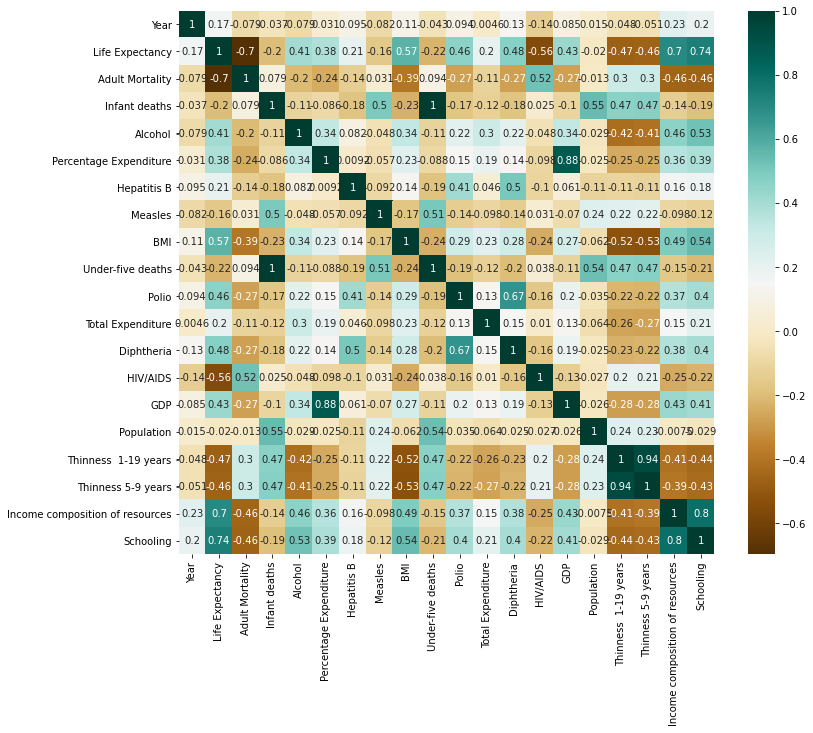

In [34]:
corr_matrix=df.corr()

plt.figure(1, figsize=(12,10))
sns.heatmap(corr_matrix, cmap='BrBG', annot=True)

corr_matrix = corr_matrix.drop('Life Expectancy')
corr_matrix['Life Expectancy'].abs().sort_values(ascending=False)

**Observation** - *Life expectancy is positively correlated with education, resource income composition, GDP, diphtheria, polio, and percentage spending.
Life expectancy is negatively correlated with Adult_mortality, Thinness_1-19_years, Thinness_5-9_years, HIV / AIDS, Under_five_deaths, and Infant_deaths.
infant deaths is positively correlated with under-five deaths
adult mortality is negatively correlated with life expectancy, income compositions of resources, schooling and positive correlated with HIV/AIDS and alcohol consumption.
GDP is positively correlated with percentage expenditure
Diphtheria has a positively with polio.*

In [35]:
cat_col = []
for x in df.dtypes.index:
    if df.dtypes[x] == 'object':
        cat_col.append(x)
cat_col

['Country',
 'Status',
 'Rate of Infant Death',
 'Quality of Schooling',
 'Life Expectancy Rating',
 'Expenditure Category',
 'Adult Mortality Rating',
 'Population Density']

In [36]:
df.apply(lambda x: len(x.unique()))

Country                             193
Year                                 16
Status                                2
Life Expectancy                     363
Adult Mortality                     426
Infant deaths                       209
Alcohol                            1076
Percentage Expenditure             2328
Hepatitis B                          88
Measles                             958
BMI                                 608
Under-five deaths                   252
Polio                                74
Total Expenditure                   818
Diphtheria                           82
HIV/AIDS                            200
GDP                                2490
Population                         2279
Thinness  1-19 years                200
Thinness 5-9 years                  207
Income composition of resources     625
Schooling                           173
Rate of Infant Death                  2
Quality of Schooling                  2
Life Expectancy Rating                2


In [37]:
z = df["Life Expectancy"]
df1 = df.drop(["Life Expectancy"], axis=1)

categorical = df1.select_dtypes(include= "O")
numerical = df1.select_dtypes(exclude= "O")

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



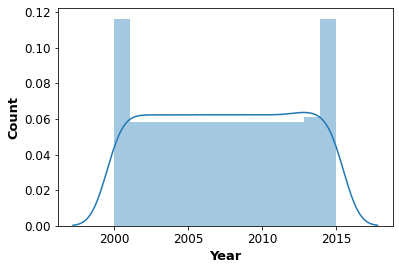

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



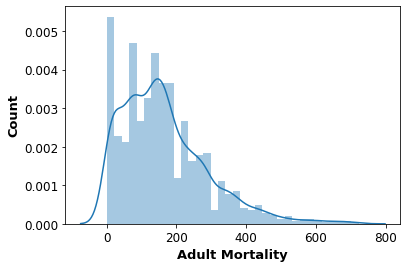

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



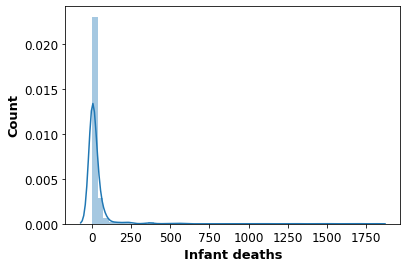

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



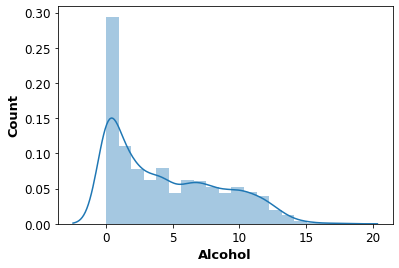

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



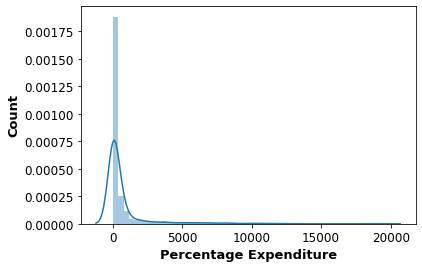

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



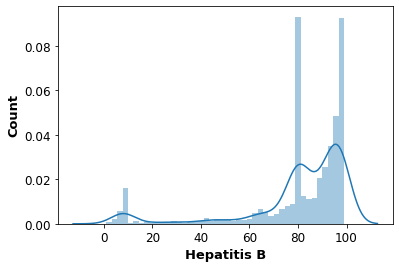

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



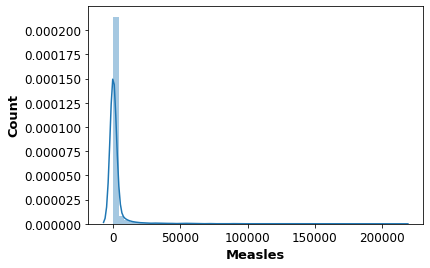

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



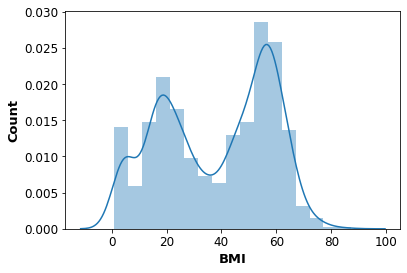

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



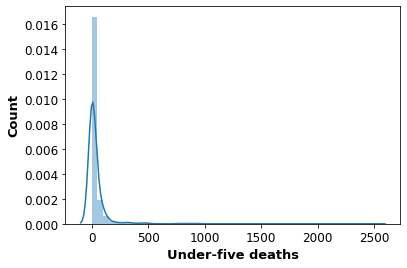

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



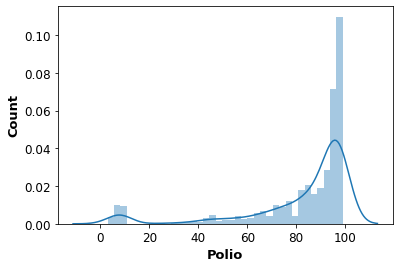

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



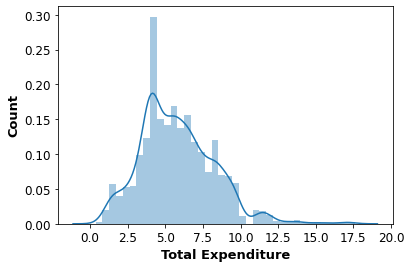

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



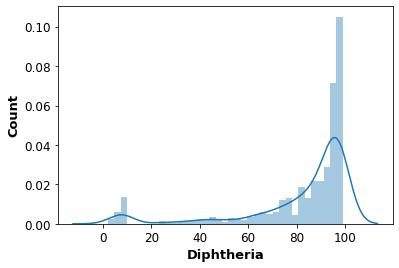

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



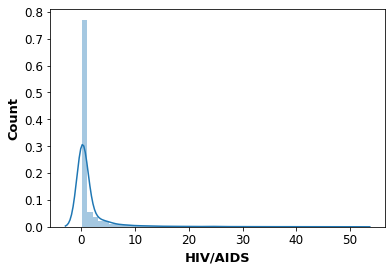

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



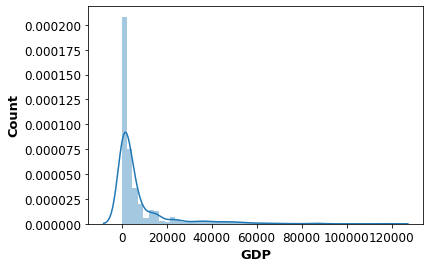

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



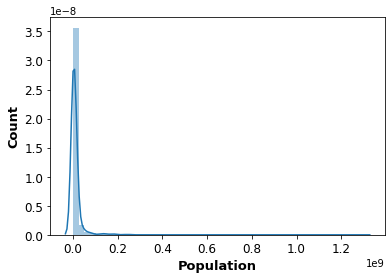

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



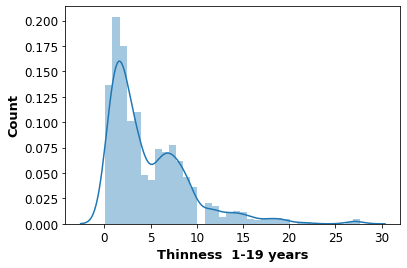

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



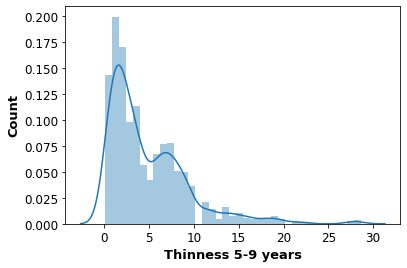

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



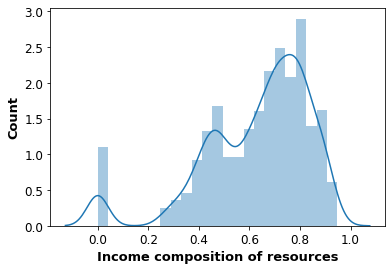

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



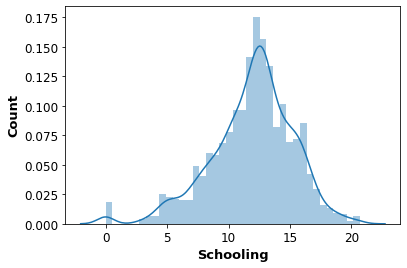

In [38]:
for feature in numerical.columns:
    sns.distplot(numerical[feature])
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.ylabel("Count", fontsize= 13, fontweight="bold")
    plt.xlabel(feature, fontsize=13, fontweight="bold")
    plt.show()

**Observation** - *Count of all the features shown with histogram*

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



Text(0.5, 0, 'Life Expectancy')

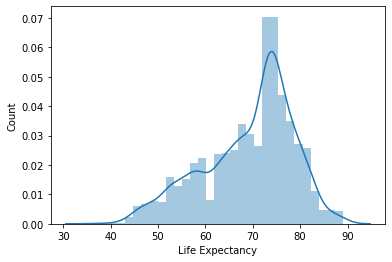

In [39]:
sns.distplot(z)
plt.ylabel("Count")
plt.xlabel("Life Expectancy")

**Observation** - *Count of the Life Expentancy shown with histogram*

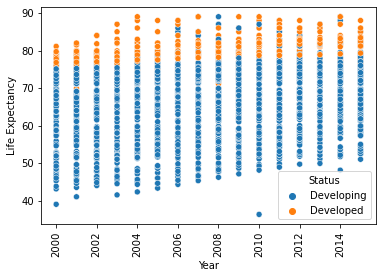

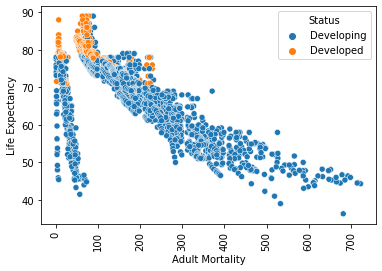

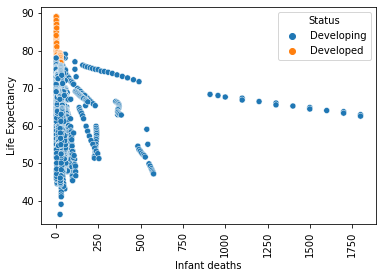

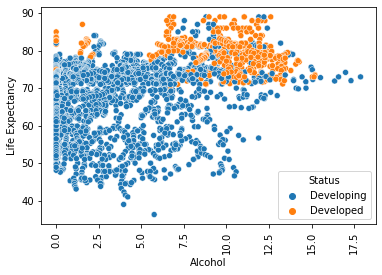

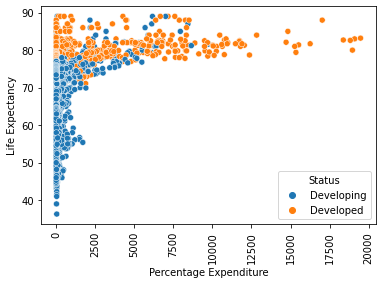

...

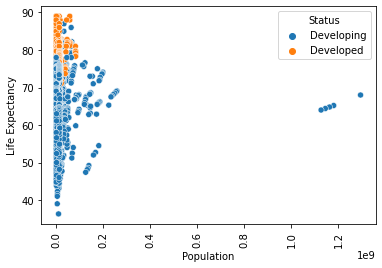

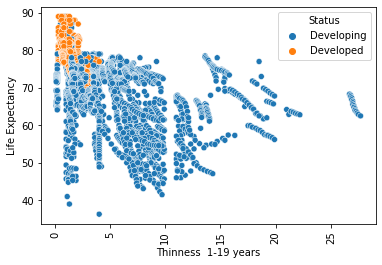

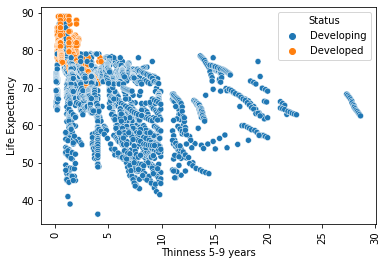

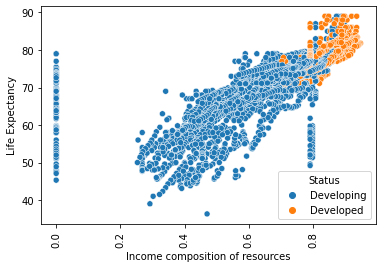

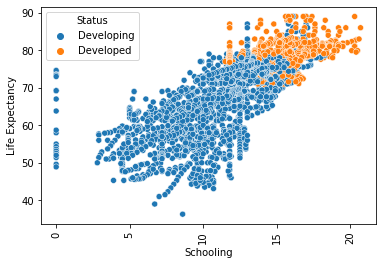

In [40]:
for feature in numerical.columns:
    sns.scatterplot(x = numerical[feature], y = z, hue = categorical.Status)
    plt.xticks(rotation=90)
    plt.ylabel("Life Expectancy")
    plt.xlabel(feature)
    plt.show()

**Observation** - *Life Expentancy shown with reference and correlation with all other features*

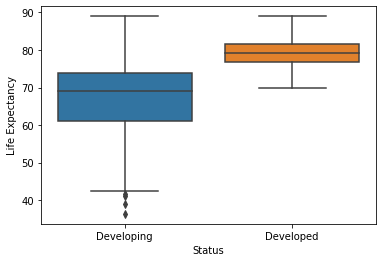

In [41]:
sns.boxplot(x = df1["Status"], y = z)
plt.ylabel("Life Expectancy")
plt.xlabel("Status")
plt.show()

**Observation** - *Showcasing the status of the population with reference to Life Expentancy*

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='GDP', ylabel='Life Expectancy'>

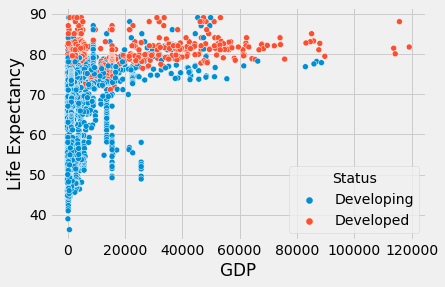

In [42]:
plt.style.use('fivethirtyeight')
sns.scatterplot(df["GDP"],df["Life Expectancy"],hue=df["Status"])

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='Status', ylabel='Life Expectancy'>

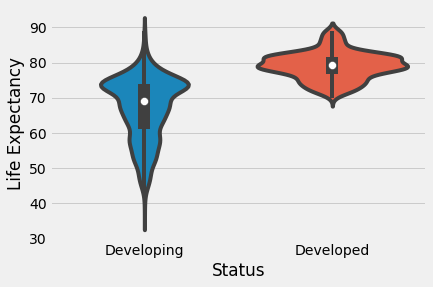

In [43]:
sns.violinplot(df['Status'],df['Life Expectancy'])

C:\Users\goyal\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='Year', ylabel='Life Expectancy'>

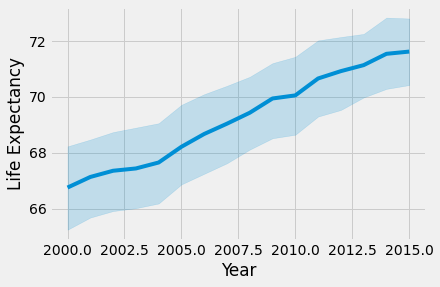

In [44]:
sns.lineplot( df['Year'],df['Life Expectancy'])

In [45]:
fig=px.histogram(df,x='Life Expectancy',template='plotly_dark')
fig.show()

In [46]:
fig=px.violin(df,x='Status',y='Life Expectancy',color='Status',template='plotly_dark',box=True,title='Life expectancy Based on Countries status')
fig.show()

In [47]:
fig = px.line((df.sort_values(by = 'Year')), x = 'Year', y = 'Life Expectancy',
    animation_frame= 'Country',animation_group='Year',color='Country',
    markers=True,template = 'plotly_dark',title='<b>Country Wise Life Expectancy over the years')
fig.show()

In [48]:
!pip install autoviz

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (2938, 22)
#######################################################################################
######################## C L A S S 

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
GDP,2490,float64,448,15.248468,84.751532,0,"fill missing, skewed: cap or drop outliers"
percentage expenditure,2328,float64,0,0.000000,79.237577,0,skewed: cap or drop outliers
Population,2278,float64,652,22.191967,77.535739,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
Alcohol,1076,float64,194,6.603131,36.623553,0,fill missing
Measles,958,int64,0,0.000000,32.607216,0,
Total expenditure,818,float64,226,7.692308,27.842069,0,fill missing
Income composition of resources,625,float64,167,5.684139,21.272975,0,"fill missing, skewed: cap or drop outliers"
BMI,608,float64,34,1.157250,20.694350,0,fill missing
Adult Mortality,425,float64,10,0.340368,14.465623,0,"fill missing, skewed: cap or drop outliers"
Life expectancy,362,float64,10,0.340368,12.321307,0,fill missing


    22 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 136
Could not draw Violin Plot


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\goyal\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     C:\Users\goyal\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     C:\Users\goyal\AppData\Roaming\nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     C:\Users\goyal\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     C:\Users\goyal\AppData\Roaming\nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]   

All Plots done
Time to run AutoViz = 48 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


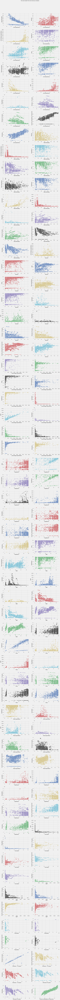

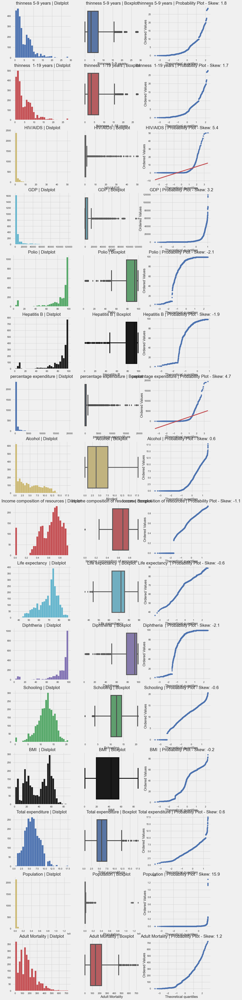

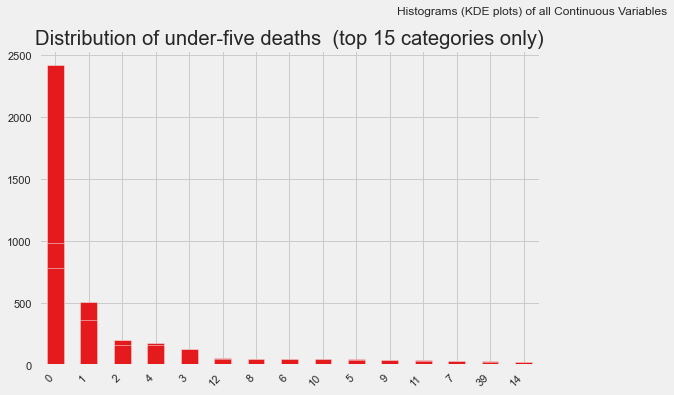

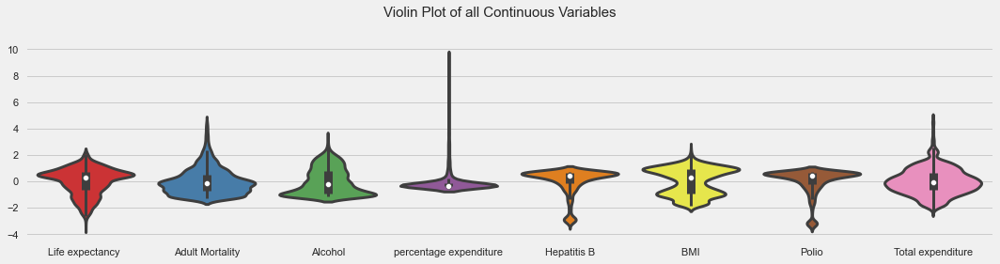

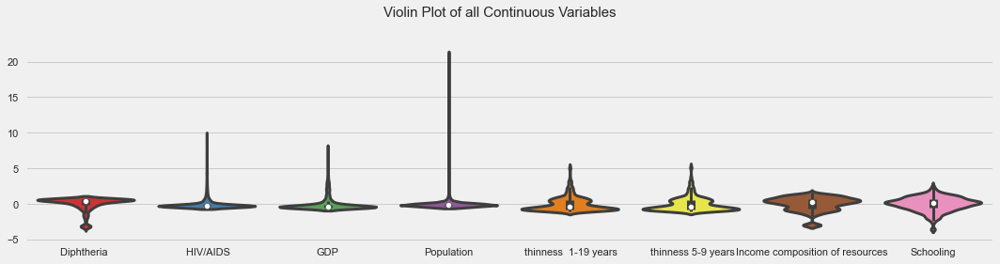

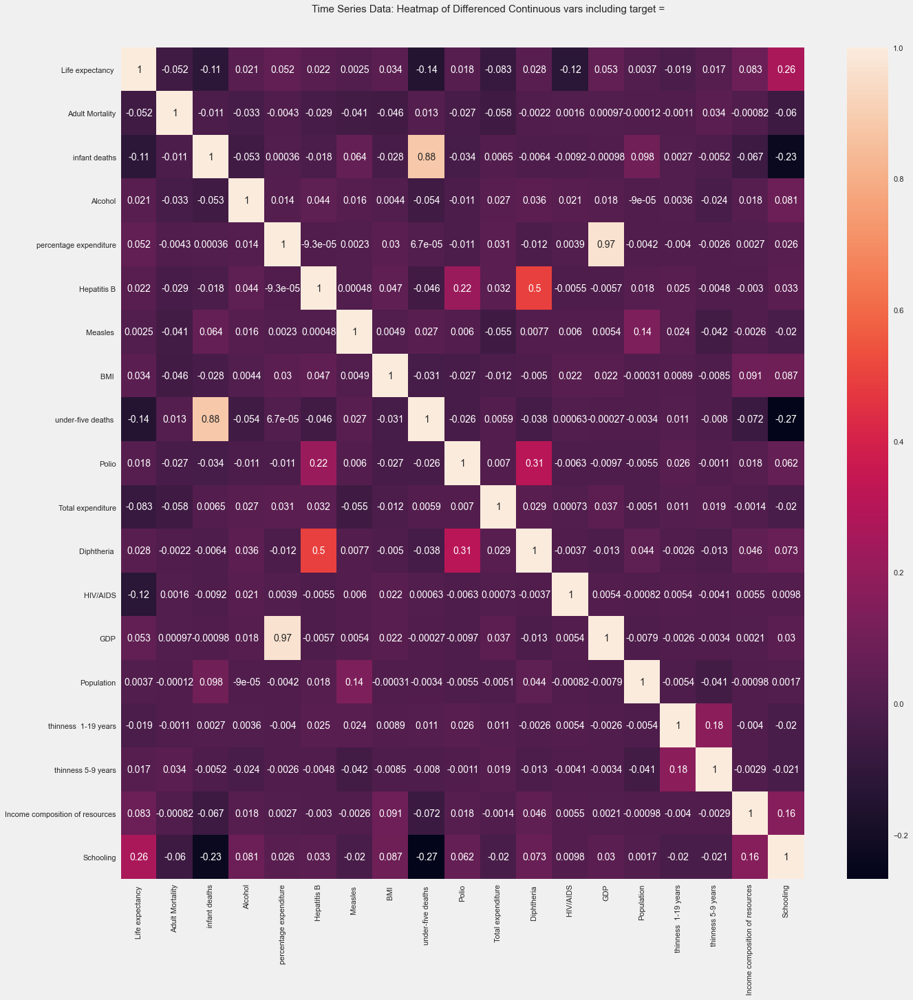

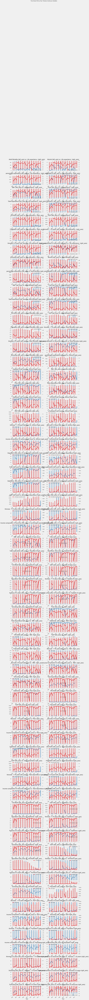

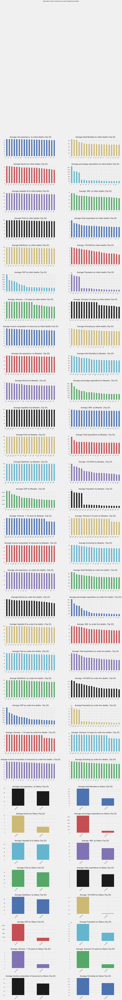

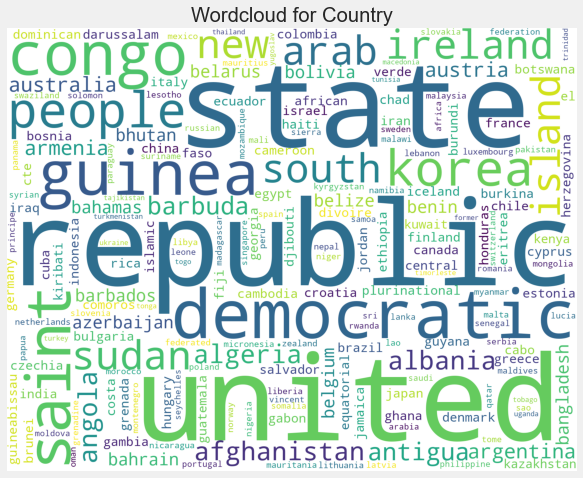

In [49]:
#importing Autoviz class

from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
AV = AutoViz_Class()
df1 = AV.AutoViz('C:/Users/goyal/Downloads/Life Expectancy Data_HV22.csv')

In [50]:
life_numeric_data = df.drop(columns=["Year","Country","Status"])

In [51]:
# Distribution graphs (histogram/bar graph) of column data
def plotPerColumnDistribution(df, nGraphShown, nGraphPerRow):
    nunique = df.nunique()
    df = df[[col for col in df if nunique[col] > 1 and nunique[col] < 50]] # For displaying purposes, pick columns that have between 1 and 50 unique values
    nRow, nCol = df.shape
    columnNames = list(df)
    nGraphRow = (nCol + nGraphPerRow - 1) / nGraphPerRow
    plt.figure(num = None, figsize = (6 * nGraphPerRow, 8 * nGraphRow), dpi = 80, facecolor = 'w', edgecolor = 'k')
    for i in range(min(nCol, nGraphShown)):
        plt.subplot(nGraphRow, nGraphPerRow, i + 1)
        columnDf = df.iloc[:, i]
        if (not np.issubdtype(type(columnDf.iloc[0]), np.number)):
            valueCounts = columnDf.value_counts()
            valueCounts.plot.bar()
        else:
            columnDf.hist()
        plt.ylabel('counts')
        plt.xticks(rotation = 90)
        plt.title(f'{columnNames[i]} (column {i})')
    plt.tight_layout(pad = 1.0, w_pad = 1.0, h_pad = 1.0)
    plt.show()

In [52]:
# Scatter and density plots
def plotScatterMatrix(df, plotSize, textSize):
    df = df.select_dtypes(include =[np.number]) # keep only numerical columns
    # Remove rows and columns that would lead to df being singular
    df = df.dropna('columns')
    df = df[[col for col in df if df[col].nunique() > 1]] # keep columns where there are more than 1 unique values
    columnNames = list(df)
    if len(columnNames) > 10: # reduce the number of columns for matrix inversion of kernel density plots
        columnNames = columnNames[:10]
    df = df[columnNames]
    ax = pd.plotting.scatter_matrix(df, alpha=0.75, figsize=[plotSize, plotSize], diagonal='kde')
    corrs = df.corr().values
    for i, j in zip(*plt.np.triu_indices_from(ax, k = 1)):
        ax[i, j].annotate('Corr. coef = %.3f' % corrs[i, j], (0.8, 0.2), xycoords='axes fraction', ha='center', va='center', size=textSize)
    plt.suptitle('Scatter and Density Plot')
    plt.show()

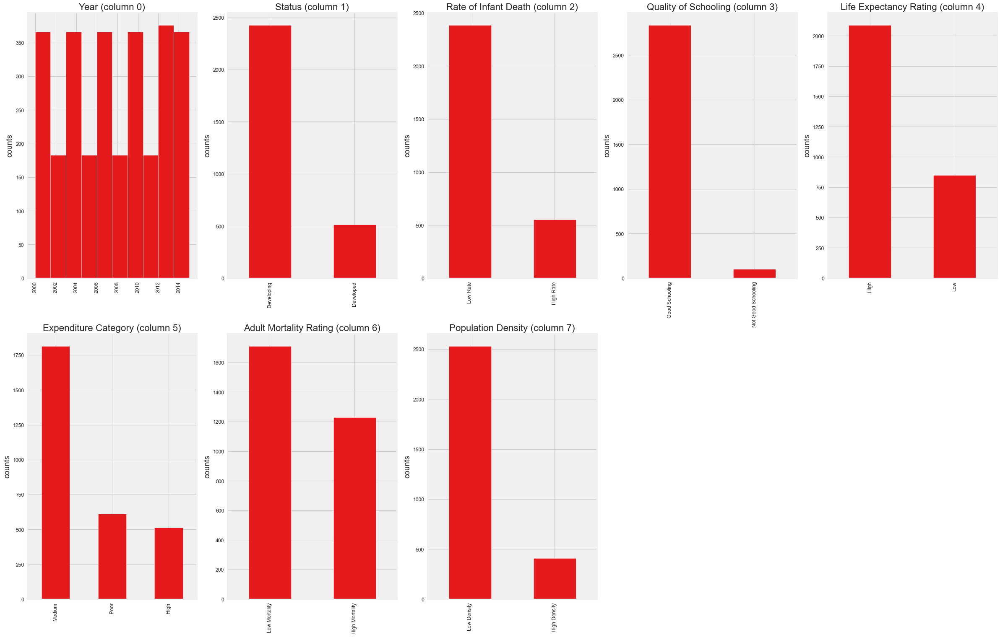

In [53]:
plotPerColumnDistribution(df, 10, 5)

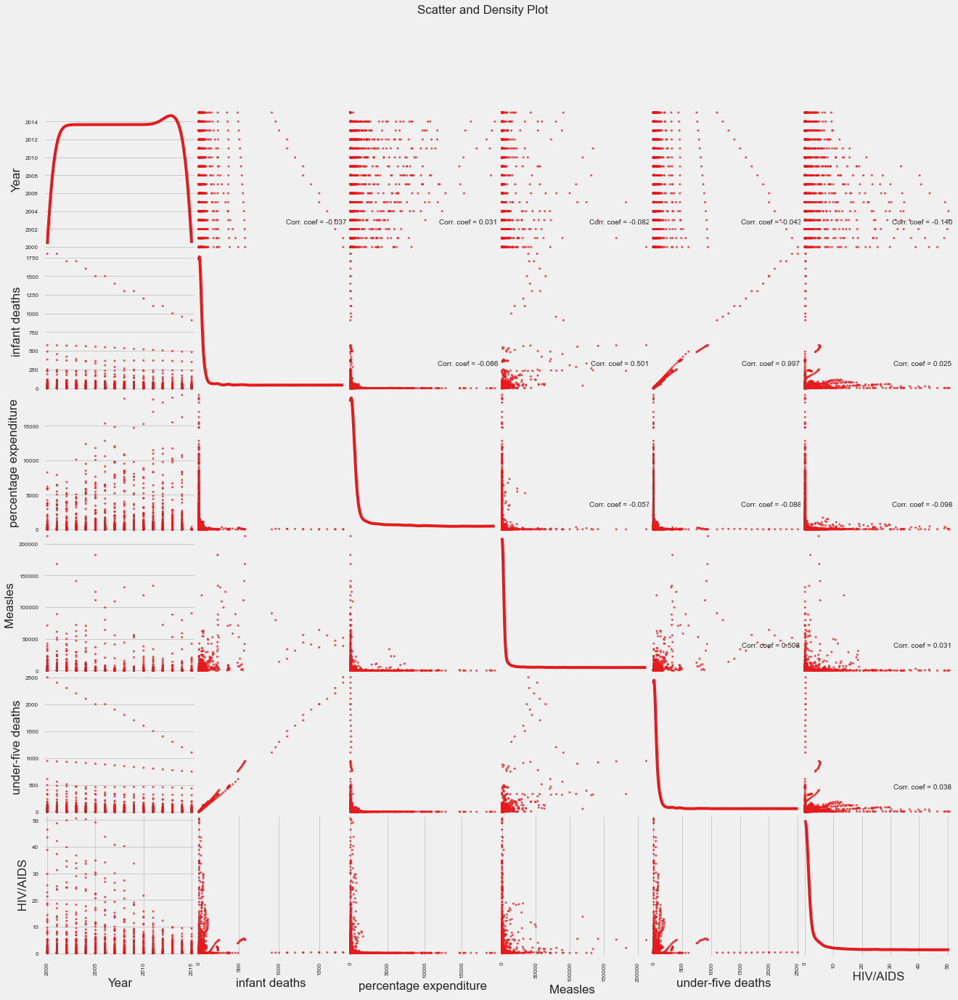

In [54]:
plotScatterMatrix(df1, 20, 10)

In [57]:
def outlier_count(col, data = df):
    
    print("\n"+15*'-' + col + 15*'-'+"\n")
    
    q75, q25 = np.percentile(data[col], [75, 25])
    iqr = q75 - q25
    min_val = q25 - (iqr*1.5)
    max_val = q75 + (iqr*1.5)
    outlier_count = len(np.where((data[col] > max_val) | (data[col] < min_val))[0])
    outlier_percent = round(outlier_count/len(data[col])*100, 2)
    print('Number of outliers: {}'.format(outlier_count))
    print('Percent of data that is outlier: {}%'.format(outlier_percent))

In [58]:
cont_vars = list(life_numeric_data)
for col in cont_vars:
    outlier_count(col)


---------------Life Expectancy---------------

Number of outliers: 17
Percent of data that is outlier: 0.58%

---------------Adult Mortality---------------

Number of outliers: 86
Percent of data that is outlier: 2.93%

---------------Infant deaths---------------

Number of outliers: 315
Percent of data that is outlier: 10.72%

---------------Alcohol---------------

Number of outliers: 0
Percent of data that is outlier: 0.0%

---------------Percentage Expenditure---------------

Number of outliers: 389
Percent of data that is outlier: 13.24%

---------------Hepatitis B---------------

Number of outliers: 298
Percent of data that is outlier: 10.14%

---------------Measles---------------

Number of outliers: 542
Percent of data that is outlier: 18.45%

---------------BMI---------------

Number of outliers: 0
Percent of data that is outlier: 0.0%

---------------Under-five deaths---------------

Number of outliers: 394
Percent of data that is outlier: 13.41%

---------------Polio--------

TypeError: unsupported operand type(s) for -: 'str' and 'str'

## **ML MODELLING**

#### ****<center>INITIAL ACCURACY MODEL****

### *Linear Regression*

In [59]:
lindata = lindata.dropna() 
lindata.corr()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
Year,1.000000,0.050771,-0.037092,0.008029,-0.113365,0.069553,0.114897,-0.053822,0.005739,0.010479,-0.016699,0.059493,0.029641,-0.123405,0.096421,0.012567,0.019757,0.014122,0.122892,0.088732
Life expectancy,0.050771,1.000000,-0.702523,-0.169074,0.402718,0.409631,0.199935,-0.068881,0.542042,-0.192265,0.327294,0.174718,0.341331,-0.592236,0.441322,-0.022305,-0.457838,-0.457508,0.721083,0.727630
Adult Mortality,-0.037092,-0.702523,1.000000,0.042450,-0.175535,-0.237610,-0.105225,-0.003967,-0.351542,0.060365,-0.199853,-0.085227,-0.191429,0.550691,-0.255035,-0.015012,0.272230,0.286723,-0.442203,-0.421171
infant deaths,0.008029,-0.169074,0.042450,1.000000,-0.106217,-0.090765,-0.231769,0.532680,-0.234425,0.996906,-0.156929,-0.146951,-0.161871,0.007712,-0.098092,0.671758,0.463415,0.461908,-0.134754,-0.214372
Alcohol,-0.113365,0.402718,-0.175535,-0.106217,1.000000,0.417047,0.109889,-0.050110,0.353396,-0.101082,0.240315,0.214885,0.242951,-0.027113,0.443433,-0.028880,-0.403755,-0.386208,0.561074,0.616975
percentage expenditure,0.069553,0.409631,-0.237610,-0.090765,0.417047,1.000000,0.016760,-0.063071,0.242738,-0.092158,0.128626,0.183872,0.134813,-0.095085,0.959299,-0.016792,-0.255035,-0.255635,0.402170,0.422088
Hepatitis B,0.114897,0.199935,-0.105225,-0.231769,0.109889,0.016760,1.000000,-0.124800,0.143302,-0.240766,0.463331,0.113327,0.588990,-0.094802,0.041850,-0.129723,-0.129406,-0.133251,0.184921,0.215182
Measles,-0.053822,-0.068881,-0.003967,0.532680,-0.050110,-0.063071,-0.124800,1.000000,-0.153245,0.517506,-0.057850,-0.113583,-0.058606,-0.003522,-0.064768,0.321946,0.180642,0.174946,-0.058277,-0.115660
BMI,0.005739,0.542042,-0.351542,-0.234425,0.353396,0.242738,0.143302,-0.153245,1.000000,-0.242137,0.186268,0.189469,0.176295,-0.210897,0.266114,-0.081416,-0.547018,-0.554094,0.510505,0.554844
under-five deaths,0.010479,-0.192265,0.060365,0.996906,-0.101082,-0.092158,-0.240766,0.517506,-0.242137,1.000000,-0.171164,-0.145803,-0.178448,0.019476,-0.100331,0.658680,0.464785,0.462289,-0.148097,-0.226013


In [60]:
linear_reg = LinearRegression()
x = lindata.GDP.values.reshape(-1,1)
y = lindata['percentage expenditure'].values.reshape(-1,1)          

linear_reg.fit(x,y)

LinearRegression()

In [61]:
b0 = linear_reg.predict(([[10000]]))       
print("b0: ", b0)

b1 = linear_reg.coef_
print("b1: ", b1)

b0:  [[1351.02549826]]
b1:  [[0.14705833]]


Mean Absolute Error:  50943.94783778519
Mean Squared Error:  3456291221.6604414
Root Mean Squared Error:  58790.230665140625


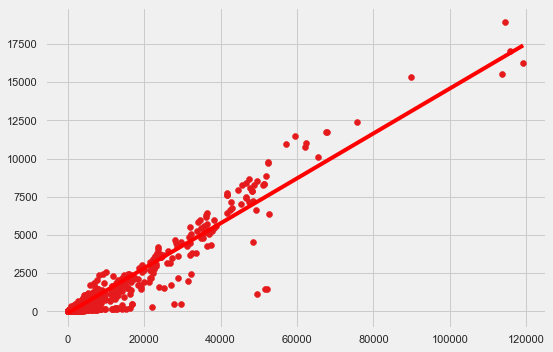

In [62]:
x_array = np.arange(min(lindata.GDP),max(lindata.GDP)).reshape(-1,1)  # this for information about the line to be predicted

plt.scatter(x,y)
y_head = linear_reg.predict(x_array)                                 # this is predict percentage of expenditure
plt.plot(x_array,y_head,color="red")
plt.show()

from sklearn import metrics
print("Mean Absolute Error: ", metrics.mean_absolute_error(x_array,y_head))
print("Mean Squared Error: ", metrics.mean_squared_error(x_array,y_head))
print("Root Mean Squared Error: ", np.sqrt(metrics.mean_squared_error(x_array, y_head)))

In [63]:
print(r2_score(y, linear_reg.predict(x)))

0.920254296978608


**Observation** - *The Acuracy of the model is 92% which is actually a great accuracy.*

**Label Encoding**

In [64]:
df.columns

Index(['Country', 'Year', 'Status', 'Life Expectancy', 'Adult Mortality',
       'Infant deaths', 'Alcohol', 'Percentage Expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'Under-five deaths', 'Polio', 'Total Expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'Thinness  1-19 years',
       'Thinness 5-9 years', 'Income composition of resources', 'Schooling',
       'Rate of Infant Death', 'Quality of Schooling',
       'Life Expectancy Rating', 'Expenditure Category',
       'Adult Mortality Rating', 'Population Density'],
      dtype='object')

In [65]:
# from sklearn.preprocessing import LabelEncoder
# columns = df["Status"]
# for feature in columns:
#     le = LabelEncoder()
#     df[feature] = le.fit_transform(df[feature])

In [66]:
df

,Country,Year,Status,Life Expectancy,Adult Mortality,Infant deaths,Alcohol,Percentage Expenditure,Hepatitis B,Measles,...,Thinness 1-19 years,Thinness 5-9 years,Income composition of resources,Schooling,Rate of Infant Death,Quality of Schooling,Life Expectancy Rating,Expenditure Category,Adult Mortality Rating,Population Density
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,17.2,17.3,0.479,10.1,High Rate,Good Schooling,High,Medium,High Mortality,High Density
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,17.5,17.5,0.476,10.0,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,17.7,17.7,0.470,9.9,High Rate,Good Schooling,Low,Medium,High Mortality,High Density
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,17.9,18.0,0.463,9.8,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,18.2,18.2,0.454,9.5,High Rate,Good Schooling,Low,Medium,High Mortality,Low Density
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,9.4,9.4,0.407,9.2,Low Rate,Good Schooling,Low,Poor,High Mortality,High Density
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,9.8,9.9,0.418,9.5,Low Rate,Good Schooling,Low,Poor,High Mortality,Low Density
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,1.2,1.3,0.427,10.0,Low Rate,Good Schooling,Low,Poor,Low Mortality,Low Density
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,1.6,1.7,0.427,9.8,Low Rate,Good Schooling,Low,Poor,High Mortality,Low Density


In [67]:
# X = df.drop(['Country', 'Year', 'Infant deaths','Rate of Infant Death','Quality of Schooling','Life Expectancy Rating','Expenditure Category','Adult Mortality Rating'],1)

**Outliers and Skewness**

In [68]:
df.skew(axis = 0, numeric_only=True)

Year                               -0.006409
Life Expectancy                    -0.639693
Adult Mortality                     1.176371
Infant deaths                       9.786963
Alcohol                             0.608494
Percentage Expenditure              4.652051
Hepatitis B                        -2.118418
Measles                             9.441332
BMI                                -0.202447
Under-five deaths                   9.495065
Polio                              -2.104863
Total Expenditure                   0.746284
Diphtheria                         -2.079481
HIV/AIDS                            5.396112
GDP                                 3.350264
Population                         18.041176
Thinness  1-19 years                1.726929
Thinness 5-9 years                  1.793291
Income composition of resources    -1.167297
Schooling                          -0.621183
dtype: float64

In [69]:
# import scipy

# for column in df.columns.drop(['Country','Status','Year','Schooling']):
#     #print(column)
#     sns.histplot(data = df[column],  bins = 25)
#     plt.title("Histogram before outlier removing")
#     plt.show()
#     if ((df[column].min()> 0)):
#         df[column],fitted_lambda= scipy.stats.boxcox(df[column] ,lmbda=None)
#     else:# using log(1+x) transformation
#         df[column] = df[column] + 1
#         df[column] = np.log(df[column])
#     sns.histplot(data = df[column],  bins = 25)
#     plt.title("Box Plot after outlier removing")
#     plt.show()

**Observation** - *It seems Box-Transformation is the best way to deal with skewness(outliers too)
However it requires the data to be greater than 0*

In [70]:
z

0       65.0
1       59.9
2       59.9
3       59.5
4       59.2
        ... 
2933    44.3
2934    44.5
2935    44.8
2936    45.3
2937    46.0
Name: Life Expectancy, Length: 2938, dtype: float64

In [71]:
df.columns

Index(['Country', 'Year', 'Status', 'Life Expectancy', 'Adult Mortality',
       'Infant deaths', 'Alcohol', 'Percentage Expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'Under-five deaths', 'Polio', 'Total Expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'Thinness  1-19 years',
       'Thinness 5-9 years', 'Income composition of resources', 'Schooling',
       'Rate of Infant Death', 'Quality of Schooling',
       'Life Expectancy Rating', 'Expenditure Category',
       'Adult Mortality Rating', 'Population Density'],
      dtype='object')

In [72]:
df.drop('Life Expectancy', axis=1, inplace=True)
df = df.join(z)

In [73]:
for column in df:
    if ((df[column].dtype == 'object')):
        print(column)
        df.drop(column, axis=1, inplace=True)

Country
Status
Rate of Infant Death
Quality of Schooling
Life Expectancy Rating
Expenditure Category
Adult Mortality Rating
Population Density


In [74]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.33, shuffle = True, random_state = 96)

In [75]:
X_train = train.iloc[:,0:-1].to_numpy()
y_train = train.iloc[:,-1].to_numpy()

X_test = test.iloc[:,0:-1].to_numpy()
y_test = test.iloc[:,-1].to_numpy()

In [76]:
print("Dimension of Train set as of now is ",X_train.shape)

Dimension of Train set as of now is  (1968, 19)


In [77]:
from sklearn.feature_selection import f_regression, mutual_info_regression
from sklearn.feature_selection import SelectKBest, SelectPercentile

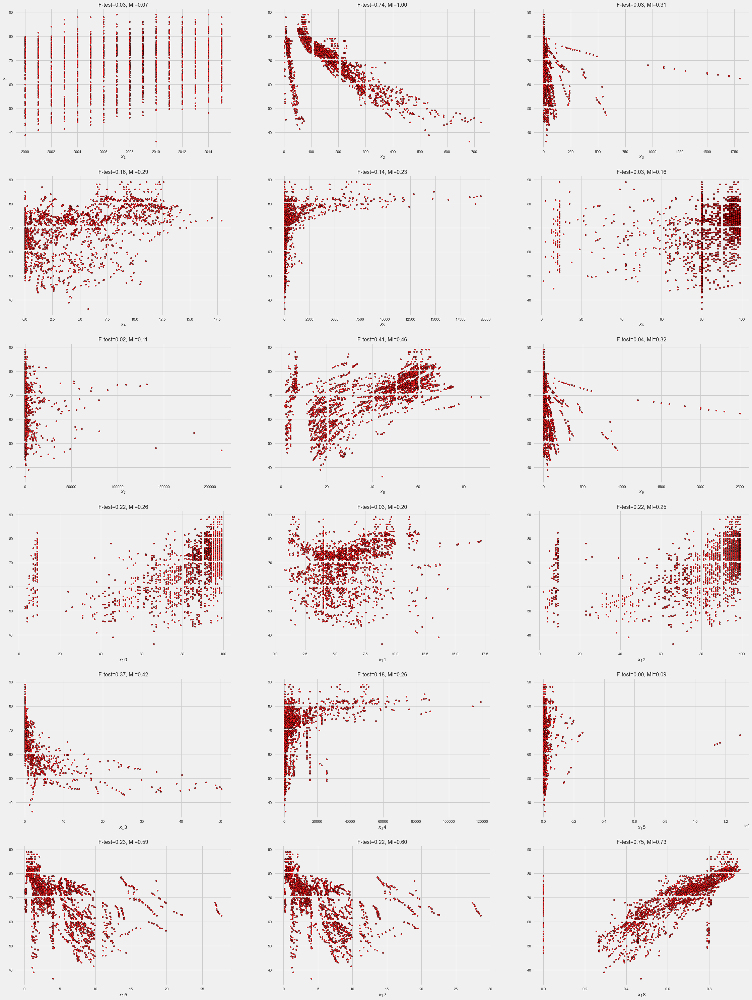

In [78]:
f_test, _ = f_regression(X_train, y_train)
f_test /= np.max(f_test)

mi = mutual_info_regression(X_train, y_train)
mi /= np.max(mi)


plt.figure(figsize=(35,50))
for i in range(18):
    plt.subplot(6, 3, i + 1)
    plt.scatter(X_train[:, i], y_train, edgecolor="black", s=20)
    plt.xlabel("$x_{}$".format(i + 1), fontsize=14)
    if i == 0:
        plt.ylabel("$y$", fontsize=14)
    plt.title("F-test={:.2f}, MI={:.2f}".format(f_test[i], mi[i]), fontsize=16)
plt.show()

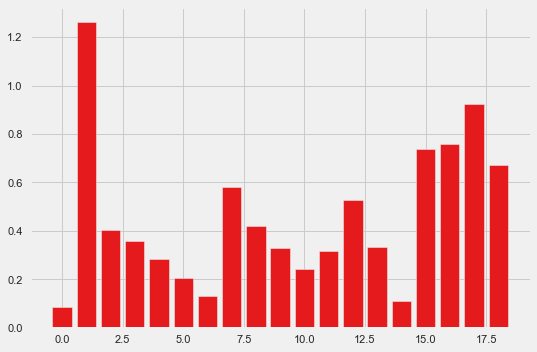

In [79]:
def select_features_mi(X_train, y_train, X_test):
    features = SelectKBest(score_func = mutual_info_regression, k= 16)
    features.fit(X_train, y_train)
    X_train_fs = features.transform(X_train)
    X_test_fs = features.transform(X_test)
    return X_train_fs, X_test_fs, features

X_train_fs, X_test_fs, feature_list_mi = select_features_mi(X_train, y_train, X_test)

for i in range(len(feature_list_mi.scores_)):
    pass
    #print('Feature %d: %f' % (i, feature_list_mi.scores_[i]))
plt.bar([i for i in range(len(feature_list_mi.scores_))], feature_list_mi.scores_)
plt.show()

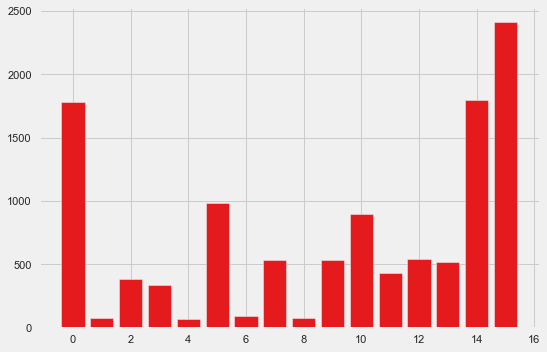

In [80]:
def select_features_f(X_train, y_train, X_test):
    features = SelectKBest(score_func = f_regression, k= 15)
    features.fit(X_train, y_train)
    X_train_fs = features.transform(X_train)
    X_test_fs = features.transform(X_test)
    return X_train_fs, X_test_fs, features

X_train_fs, X_test_fs, feature_list_f = select_features_f(X_train_fs, y_train, X_test_fs)

for i in range(len(feature_list_f.scores_)):
    pass
    #print('Feature %d: %f' % (i, feature_list_f.scores_[i]))
plt.bar([i for i in range(len(feature_list_f.scores_))], feature_list_f.scores_)
plt.show()

In [81]:
print("Dimension of Train set prior to feature selection ",X_train.shape)

Dimension of Train set prior to feature selection  (1968, 19)


In [82]:
X_train = X_train_fs
X_test = X_test_fs

In [83]:
print("Dimension of Train set after to feature selection ",X_train.shape)

Dimension of Train set after to feature selection  (1968, 15)


**Linear Regression**

In [84]:
import math
from sklearn import preprocessing

X_train = preprocessing.scale(X_train)
X_test = preprocessing.scale(X_test)

In [85]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()

In [86]:
linear_reg_model = lr.fit(X_train,y_train)

y_train_pred = linear_reg_model.predict(X_train)
y_test_pred = linear_reg_model.predict(X_test)

print("The training R^2 score for linear model ",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for linear model ",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for linear model  0.8199826368689731

The training RMSE score for linear model  4.029851132938134


 **Ridge**

In [87]:
from sklearn.model_selection import GridSearchCV

from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
from sklearn.linear_model import Ridge

ridge = Ridge()

param_grid = {
            "alpha": [1e0, 0.1, 1e-2, 1e-3],
            'tol': [1]
             }
grid = HalvingGridSearchCV(ridge, param_grid, refit = True, verbose = -1, n_jobs=-1, return_train_score = True)

ridge_best_model = grid.fit(X_train, y_train) 

print(grid.best_params_)

n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 656
max_resources_: 1968
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 4
n_resources: 656
----------
iter: 1
n_candidates: 2
n_resources: 1968
{'alpha': 0.01, 'tol': 1}


In [88]:
y_train_pred = ridge_best_model.predict(X_train)
y_test_pred = ridge_best_model.predict(X_test)

print("The training R^2 score for best Ridge Regression model is",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for best Ridge Regression model is",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for best Ridge Regression model is 0.8199826050496987

The training RMSE score for best Ridge Regression model is 4.029851489089705


**Lasso**

In [89]:
from sklearn.linear_model import Lasso

lasso = Lasso()

param_grid = {
            "alpha": [1e0, 0.1, 1e-2, 1e-3],
            'tol': [1]
             }
grid = HalvingGridSearchCV(lasso, param_grid, refit = True, verbose = -1, n_jobs=-1, return_train_score = True)

lasso_best_model = grid.fit(X_train, y_train) 

print(grid.best_params_) 

#print(grid.refit_time_)

n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 656
max_resources_: 1968
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 4
n_resources: 656
----------
iter: 1
n_candidates: 2
n_resources: 1968
{'alpha': 1.0, 'tol': 1}


In [90]:
y_train_pred = lasso_best_model.predict(X_train)
y_test_pred = lasso_best_model.predict(X_test)

print("The training R^2 score for best Lasso Regression model is",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for best Lasso Regression model is",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for best Lasso Regression model is 0.7787117058360689

The training RMSE score for best Lasso Regression model is 4.467977996281459


**Polynomial Regression**

In [91]:
from sklearn.preprocessing import PolynomialFeatures

for alpha in range(1,4):
    
    polynomial_regressor = PolynomialFeatures(degree = alpha)
    
    X_poly_train = polynomial_regressor.fit_transform(X_train)
    X_poly_test = polynomial_regressor.fit_transform(X_test)
    
    poly_reg_model = LinearRegression().fit(X_poly_train,y_train)
    
    y_train_pred = poly_reg_model.predict(X_poly_train)
    y_test_pred = poly_reg_model.predict(X_poly_test)

    train_score = math.sqrt(mean_squared_error(y_train_pred,y_train))
    test_score = math.sqrt(mean_squared_error(y_test_pred,y_test))

    print("The training R^2 score for polynomial model with degree ",alpha, "is",r2_score(y_train, y_train_pred))
    print("The test R^2 score for polynomial model with degree ",alpha, "is",r2_score(y_test, y_test_pred))
    print()
    print("The training RMSE score for polynomial model with degree ",alpha, "is",math.sqrt(mean_squared_error(y_train_pred,y_train)))
    print("The test RMSE score for polynomial model with degree ",alpha, "is",math.sqrt(mean_squared_error(y_test_pred,y_test)))
    print()
    if (alpha == 1):
        print("Basically Linear Regression")
        print()

The training R^2 score for polynomial model with degree  1 is 0.8199826368689731
The test R^2 score for polynomial model with degree  1 is 0.8304359449753929

The training RMSE score for polynomial model with degree  1 is 4.029851132938134
The test RMSE score for polynomial model with degree  1 is 3.920218201778083

Basically Linear Regression

The training R^2 score for polynomial model with degree  2 is 0.9294636564778369
The test R^2 score for polynomial model with degree  2 is 0.8441104173259685

The training RMSE score for polynomial model with degree  2 is 2.5225412488750747
The test RMSE score for polynomial model with degree  2 is 3.758823133559795

The training R^2 score for polynomial model with degree  3 is 0.9778817892459089
The test R^2 score for polynomial model with degree  3 is -79.80971506397225

The training RMSE score for polynomial model with degree  3 is 1.4125596653975159
The test RMSE score for polynomial model with degree  3 is 85.58056149250152



In [92]:
polynomial_regressor = PolynomialFeatures(degree = 1)
    
X_poly_train = polynomial_regressor.fit_transform(X_train)
X_poly_test = polynomial_regressor.fit_transform(X_test)

poly_reg_model = LinearRegression().fit(X_poly_train,y_train)

**Kernel Ridge Regression**

In [93]:
from sklearn.kernel_ridge import KernelRidge

krr = KernelRidge()

param_grid = {
            "alpha": [1e0, 0.1, 1e-2, 1e-3], 
            "gamma": np.logspace(-2, 2, 5),
            "degree": [3, 5, 7, 9]
             }
grid = HalvingGridSearchCV(krr, param_grid, refit = True, verbose = -1, n_jobs=-1, return_train_score = True)

krr_best_model = grid.fit(X_train, y_train) 

print(grid.best_params_) 

#print(grid.refit_time_)

n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 72
max_resources_: 1968
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 80
n_resources: 72
----------
iter: 1
n_candidates: 27
n_resources: 216
----------
iter: 2
n_candidates: 9
n_resources: 648
----------
iter: 3
n_candidates: 3
n_resources: 1944
{'alpha': 1.0, 'degree': 5, 'gamma': 1.0}


In [94]:
y_train_pred = krr_best_model.predict(X_train)
y_test_pred = krr_best_model.predict(X_test)

print("The training R^2 score for best Kernel Ridge model is",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for best Kernel Ridge model is",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for best Kernel Ridge model is -52.17540145936724

The training RMSE score for best Kernel Ridge model is 69.26075060614016


**Decision Tree Regressor**

In [95]:
from sklearn.tree import DecisionTreeRegressor

dtr = DecisionTreeRegressor()

param_grid = {
            'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'],
            'max_depth' : [3,7,11,15,19],
            'min_weight_fraction_leaf':[0.0005,0.001,0.005],
            'max_features':['auto','log2','sqrt',None],
             }
grid = HalvingGridSearchCV(dtr, param_grid, refit = True, verbose = -1,n_jobs=-1, error_score = 'raise')

dtr_best_model = grid.fit(X_train, y_train) 

print(grid.best_params_)

n_iterations: 5
n_required_iterations: 5
n_possible_iterations: 5
min_resources_: 24
max_resources_: 1968
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 240
n_resources: 24
----------
iter: 1
n_candidates: 80
n_resources: 72
----------
iter: 2
n_candidates: 27
n_resources: 216
----------
iter: 3
n_candidates: 9
n_resources: 648
----------
iter: 4
n_candidates: 3
n_resources: 1944
{'criterion': 'friedman_mse', 'max_depth': 19, 'max_features': None, 'min_weight_fraction_leaf': 0.005}


In [96]:
y_train_pred = dtr_best_model.predict(X_train)
y_test_pred = dtr_best_model.predict(X_test)

print("The training R^2 score for best Decision Tree model is",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for best Decision Tree model is",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for best Decision Tree model is 0.961125947572152

The training RMSE score for best Decision Tree model is 1.8726719835198478


**Random Forest Regressor**

In [97]:
from sklearn.ensemble import RandomForestRegressor

rfr = RandomForestRegressor()

param_grid = param_grid = {
        'criterion': ['squared_error', 'absolute_error', 'poisson'],
        'max_depth': [100, 110],
        'max_features': [4, 5],
        'min_samples_leaf': [2, 4],
        'min_samples_split': [6],
        'n_estimators': [500,1000]
}
grid = HalvingGridSearchCV(rfr, param_grid, refit = True, verbose = -1,n_jobs=-1)

rfr_best_model = grid.fit(X_train, y_train) 

print(grid.best_params_)

#print(grid.refit_time_)

n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 72
max_resources_: 1968
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 48
n_resources: 72
----------
iter: 1
n_candidates: 16
n_resources: 216
----------
iter: 2
n_candidates: 6
n_resources: 648
----------
iter: 3
n_candidates: 2
n_resources: 1944
{'criterion': 'poisson', 'max_depth': 110, 'max_features': 5, 'min_samples_leaf': 2, 'min_samples_split': 6, 'n_estimators': 1000}


In [98]:
y_train_pred = rfr_best_model.predict(X_train)
y_test_pred = rfr_best_model.predict(X_test)

print("The training R^2 score for best Random Forest model is",r2_score(y_train, y_train_pred))
print()
print("The training RMSE score for best Random Forest model is",math.sqrt(mean_squared_error(y_train_pred,y_train)))

The training R^2 score for best Random Forest model is 0.9877469914602915

The training RMSE score for best Random Forest model is 1.051364172131169


In [99]:
models = []

models.append(('Linear Regression', linear_reg_model))
models.append(('Ridge(Linear) Regression', ridge_best_model))
models.append(('Lasso(Linear) Regression', lasso_best_model))
models.append(('Polynomial Regression', poly_reg_model))
#models.append(('Kernel Ridge Regression', krr_best_model))
models.append(('Decision Tree', dtr_best_model))
models.append(('Random Forest', rfr_best_model))



model_name = []
RMSE = []
R2 = []

Y_TEST_PRED = []

    
for name, model in models:
    if (name == 'Polynomial Regression'):
        model_name.append(name)
        y_test_pred = model.predict(X_poly_test)
        rmse = math.sqrt(mean_squared_error(y_test_pred,y_test))
        r2 = r2_score(y_test, y_test_pred)

        RMSE.append(rmse)
        R2.append(r2)
        Y_TEST_PRED.append(y_test_pred)
    else:
        model_name.append(name)
        y_test_pred = model.predict(X_test)
        rmse = math.sqrt(mean_squared_error(y_test_pred,y_test))
        r2 = r2_score(y_test, y_test_pred)
        
        RMSE.append(rmse)
        R2.append(r2)
        Y_TEST_PRED.append(y_test_pred)
        
model_score = pd.DataFrame(zip(model_name, RMSE, R2) , columns=['Name', 'RMSE','R2'])

model_score = model_score.sort_values(by='RMSE', ascending=False)

#print(model_score.sort_values(by=['RMSE']))
model_score

,Name,RMSE,R2
2,Lasso(Linear) Regression,4.303179,0.795689
3,Polynomial Regression,3.920218,0.830436
0,Linear Regression,3.920218,0.830436
1,Ridge(Linear) Regression,3.920183,0.830439
4,Decision Tree,2.523787,0.929722
5,Random Forest,1.902217,0.960076
